In [1]:
import os
import sys
import glob
import scipy
import sklearn
import matplotlib
import numpy as np
import pandas as pd
import seaborn as sns
from collections import defaultdict
from matplotlib import pyplot as plt
from matplotlib.backends.backend_pdf import PdfPages

%matplotlib inline
sns.set_style('whitegrid')
pd.set_option('display.max_rows', 100)
matplotlib.rcParams['ps.fonttype'] = 42
matplotlib.rcParams['pdf.fonttype'] = 42
pd.set_option('display.max_columns', 100)

sns.set_palette("Set2")


## Read in information

In [2]:
DATE = '04202020'

PLdb = pd.read_csv('/home/mattolm/user_data/Covid_19/Pipeline/Jupyter/{0}_SRA_parsed_info_v2.csv'.format(DATE))
for c in ['coverage', 'breadth']:
    del PLdb[c]

In [3]:
saveloc = '/home/mattolm/user_data/Covid_19/Pipeline/Jupyter/{0}_tables/'.format(DATE)

COdb = pd.read_csv(saveloc + 'COVID_genome_coverage.csv')
Odb = pd.read_csv(saveloc + 'COVID_positional_coverage_v2.csv.gz')
MGdb = pd.read_csv(saveloc + 'COVID_gene_coverage_v4.csv')
POdb = pd.read_csv('/home/mattolm/user_data/Covid_19/datatables/COVID_genes_positional_v4.csv')
Gdb = pd.read_csv('/home/mattolm/user_data/Covid_19/datatables/COVID_genes_table_v4.csv')


In [4]:
COdb.head()

,scaffold,length,breadth,coverage,median_cov,std_cov,bases_w_0_coverage,mean_clonality,median_clonality,mean_microdiversity,median_microdiversity,rarefied_mean_microdiversity,rarefied_median_microdiversity,unmaskedBreadth,rarefied_breadth,expected_breadth,SNPs,Reference_SNPs,BiAllelic_SNPs,MultiAllelic_SNPs,consensus_SNPs,population_SNPs,conANI,popANI,Run,genome
0,NC_045512.2,29903,0.999131,969.343812,812,807.972740,26,0.991916,0.995506,0.008084,0.004494,0.007682,0.0,0.997458,0.991974,1.000000,64,2,50,12,6,3,0.999799,0.999899,SRR11542288,MT039887.1
1,NC_045512.2,29903,0.999064,1372.825770,1180,1062.479273,28,0.991800,0.995488,0.008200,0.004512,0.007680,0.0,0.998027,0.995519,1.000000,91,2,78,11,4,3,0.999866,0.999899,SRR11542289,MT039887.1
2,NC_045512.2,29903,0.989265,2968.623549,1286,3938.030320,321,0.998092,1.000000,0.001908,0.000000,0.001493,0.0,0.954754,0.897669,1.000000,59,6,51,2,10,6,0.999650,0.999790,SRR11542243,MT039887.1
3,NC_045512.2,29903,0.790623,436.001371,202,632.044924,6261,0.998721,1.000000,0.001279,0.000000,0.001078,0.0,0.750694,0.654416,1.000000,26,2,24,0,4,2,0.999822,0.999911,SRR11542244,MT039887.1
4,NC_045512.2,29903,0.034813,0.034813,0,0.183305,28862,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,0.000000,0.030272,0,0,0,0,0,0,0.000000,0.000000,SRR11524818,MT039887.1


In [5]:
Odb.head()

,Run,position,coverage,normalized_coverage,microdiversity,normalized_microdiversity,rarefied_microdiversity,normalized_rarefied_microdiversity
0,SRR11542288,0,3,0.000014,NaN,NaN,NaN,NaN
1,SRR11542288,1,3,0.000014,NaN,NaN,NaN,NaN
2,SRR11542288,2,3,0.000014,NaN,NaN,NaN,NaN
3,SRR11542288,3,3,0.000014,NaN,NaN,NaN,NaN
4,SRR11542288,4,3,0.000014,NaN,NaN,NaN,NaN


In [6]:
MGdb.head()

,Run,gene,coverage,normalized_microdiversity,normalized_microdiversity_rank,coverage_rank
0,SRR11059940,3'UTR,13.192140,0.001564,14.0,15.0
1,SRR11059940,5'UTR,1.607547,NaN,NaN,1.0
2,SRR11059940,GU280_gp01_stem_loop,16.060241,0.004236,30.0,22.0
3,SRR11059940,GU280_gp11_stem_loop,19.430769,0.004316,31.0,27.0
4,SRR11059940,YP_009724389.1,12.438965,0.001565,15.0,13.0


In [7]:
Gdb

,type,gene,scaffold,direction,product,translated,ID,start,end,location,stop_included
0,5'UTR,5'UTR,NC_045512.2,1,NaN,False,5'UTR,0,265,[0:265](+),NaN
1,CDS,orf1ab,NC_045512.2,1,orf1ab polyprotein,True,YP_009724389.1,265,21552,"join{[265:13468](+), [13467:21555](+)}",True
2,mat_peptide,leader protein,NC_045512.2,1,leader protein,True,YP_009725297.1,265,805,[265:805](+),False
3,mat_peptide,nsp2,NC_045512.2,1,nsp2,True,YP_009725298.1,805,2719,[805:2719](+),False
4,mat_peptide,nsp3,NC_045512.2,1,nsp3,True,YP_009725299.1,2719,8554,[2719:8554](+),False
5,mat_peptide,nsp4,NC_045512.2,1,nsp4,True,YP_009725300.1,8554,10054,[8554:10054](+),False
6,mat_peptide,3C-like proteinase,NC_045512.2,1,3C-like proteinase,True,YP_009725301.1,10054,10972,[10054:10972](+),False
7,mat_peptide,nsp6,NC_045512.2,1,nsp6,True,YP_009725302.1,10972,11842,[10972:11842](+),False
8,mat_peptide,nsp7,NC_045512.2,1,nsp7,True,YP_009725303.1,11842,12091,[11842:12091](+),False
9,mat_peptide,nsp8,NC_045512.2,1,nsp8,True,YP_009725304.1,12091,12685,[12091:12685](+),False


In [8]:
save_loc = '/home/mattolm/user_data/Covid_19/Pipeline/Jupyter/{0}_figures/'.format(DATE)
if not os.path.isdir(save_loc):
    os.mkdir(save_loc)
if not os.path.isdir(save_loc + 'distros'):
    os.mkdir(save_loc + 'distros')

## Make QC figures relating various metadata to things

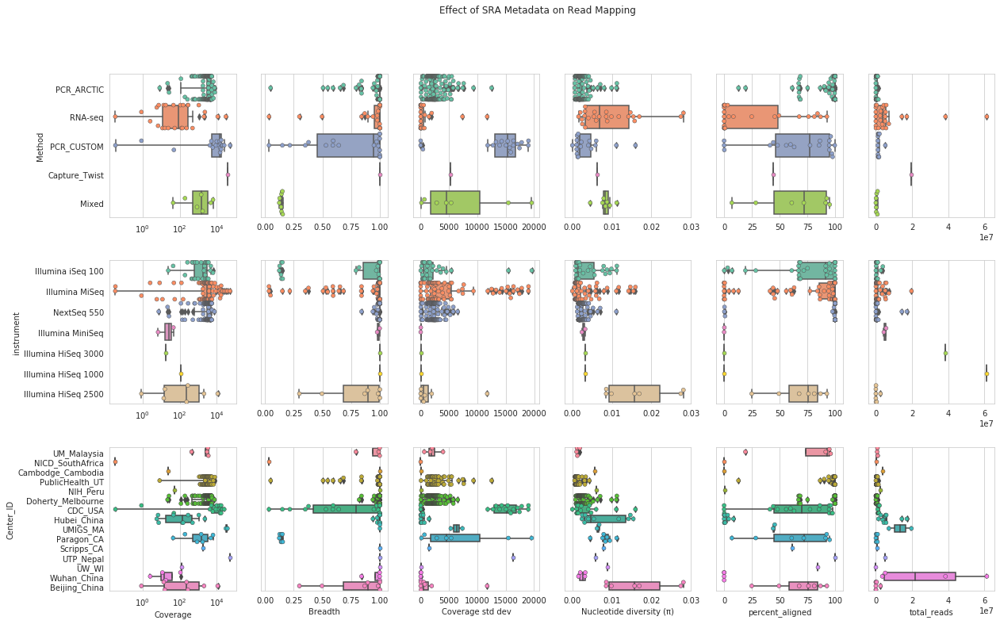

In [9]:
fdb = pd.merge(PLdb, COdb, on='Run')
fdb['mean_microdiversity'] = 1 - fdb['mean_clonality']

m2m = {'coverage':'Coverage', 'breadth':'Breadth', 'std_cov':'Coverage std dev', 'mean_microdiversity':'Nucleotide diversity (π)'}
fdb = fdb.rename(columns=m2m)

sns.set_style('whitegrid')
VARIABLES = ['Method', 'instrument', 'Center_ID']
METRICS = ['Coverage', 'Breadth', 'Coverage std dev', 'Nucleotide diversity (π)', 'percent_aligned', 'total_reads']

fig, axs = plt.subplots(
            len(VARIABLES), len(METRICS), figsize=(20, 12), gridspec_kw={"hspace": 0.3})


for m, met in enumerate(METRICS):
    for v, var in enumerate(VARIABLES):
        ax = axs[v][m]
        g = sns.boxplot(data=fdb, y=var, x=met, ax=ax)
        g = sns.swarmplot(data=fdb, y=var, x=met, ax=ax, linewidth=0.5)
        if m != 0:
            ax.set_ylabel('')
            ax.set_yticks([])
        if v != len(VARIABLES) - 1:
            ax.set_xlabel('')
            #ax.set_yticks([])
        if met in ['Coverage']:
            g.set_xscale("log")
        #plt.xticks(rotation=90)
plt.suptitle('Effect of SRA Metadata on Read Mapping')
plt.gcf().savefig(save_loc + 'QC_boxplots_{0}_v2.png'.format(DATE), bbox_inches='tight', dpi=200)
plt.show()
    

## Make a set of filtered reads

In [10]:
FRUNS = set(COdb[(COdb['coverage'] >= 50) & (COdb['breadth'] >= 0.9)]['Run'].unique().tolist())
print("{0} Filtered runs".format(len(FRUNS)))

406 Filtered runs


In [11]:
PLdb[PLdb['Run'].isin(FRUNS)]['Center_ID'].value_counts()

Doherty_Melbourne    319
PublicHealth_UT       55
CDC_USA                9
Hubei_China            6
UM_Malaysia            3
Beijing_China          2
UMIGS_MA               2
NIH_Peru               1
UTP_Nepal              1
Scripps_CA             1
UW_WI                  1
Wuhan_China            1
Name: Center_ID, dtype: int64

## Plot timing

/home/mattolm/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:6: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  
/home/mattolm/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


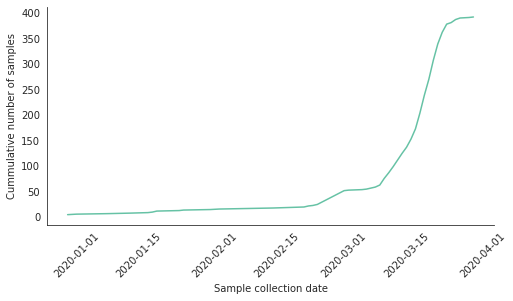

In [12]:
import datetime

sns.set_style('white')

fdb = PLdb[PLdb['Run'].isin(FRUNS)]
fdb['collection_date'] = pd.to_datetime(fdb['collection_date'])
fdb['release_date'] = [datetime.datetime.fromtimestamp(x) for x in fdb['release_date']]
fdb = fdb[~fdb['collection_date'].isna()]
fdb = fdb[fdb['collection_date'] > pd.to_datetime("2019-01-19")]

table = defaultdict(list)
for date in fdb['collection_date'].unique():
    table['date'].append(date)
    table['samples'].append(len(fdb[fdb['collection_date'] <= date]))
db = pd.DataFrame(table)

db = db.sort_values('date')
sns.lineplot(data=db, x='date', y='samples')

ax = plt.gca()
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)
plt.xlabel('Sample collection date')
plt.ylabel("Cummulative number of samples")

#pretty_date = "{0}-{1}-{2}".format(DATE.split('_')[2], DATE.split('_')[1], DATE.split('_')[0])
#plt.title("Last updated {0}".format(pretty_date))

plt.xticks(rotation=45)

plt.gcf().set_size_inches(8, 4)

plt.gcf().savefig(save_loc + 'NumberOfSamples_{0}.png'.format(DATE), bbox_inches='tight', dpi=200)
plt.show()

## Look at distributions

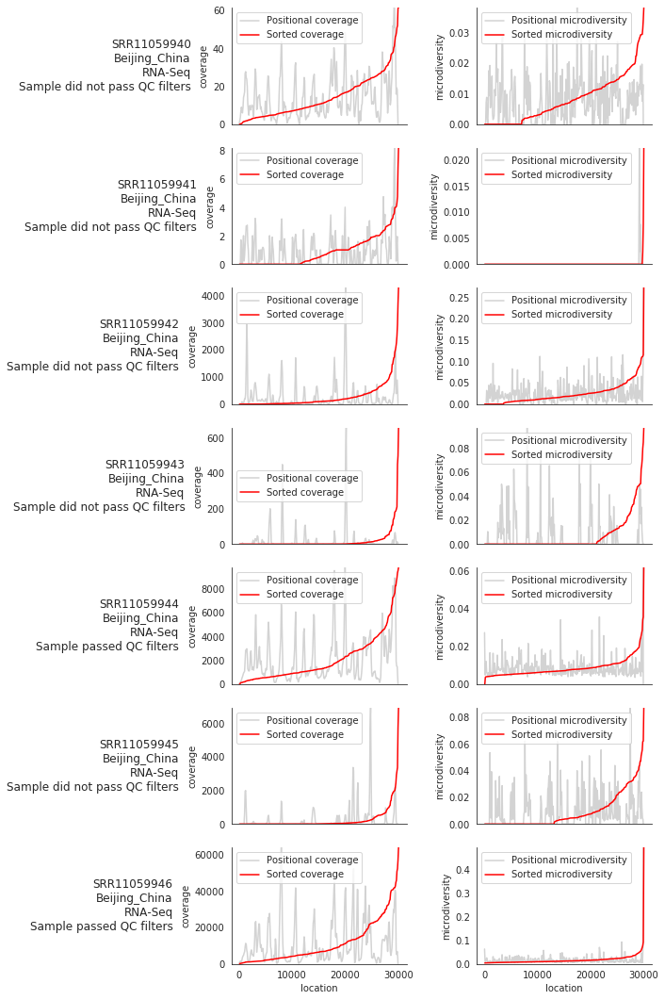

/home/mattolm/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:69: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.
/home/mattolm/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:69: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.


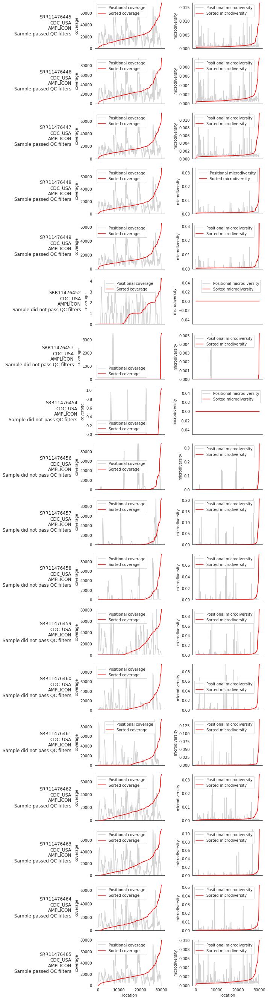

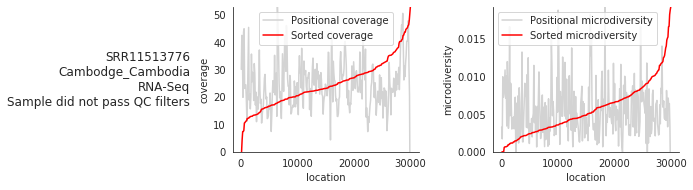

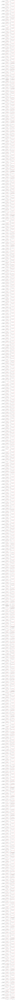

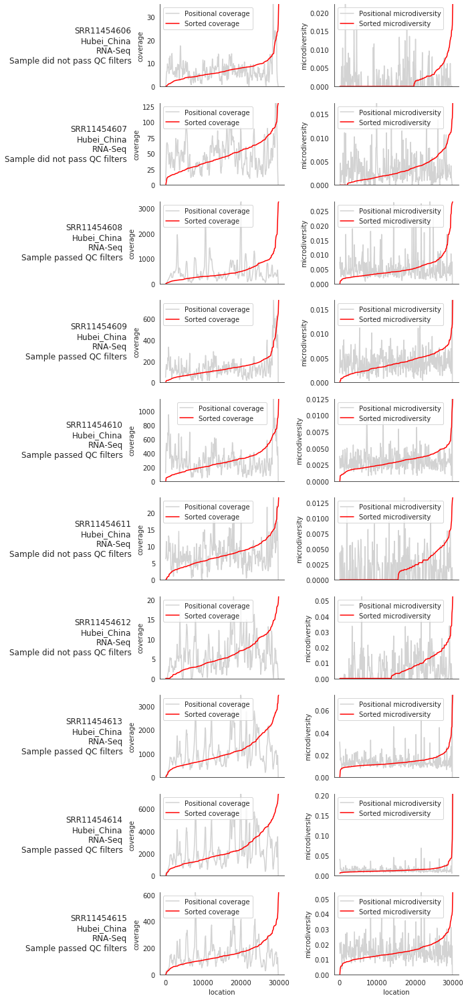

/home/mattolm/miniconda3/lib/python3.7/site-packages/ipykernel_launcher.py:69: UserWarning: Attempting to set identical bottom == top == 0 results in singular transformations; automatically expanding.


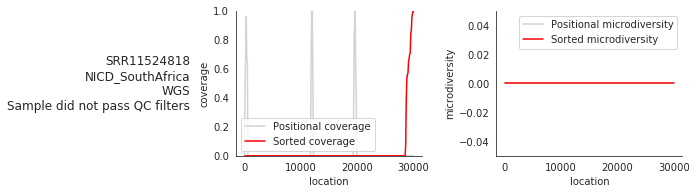

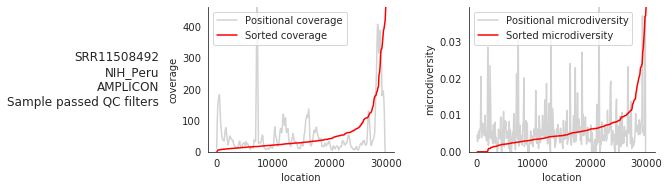

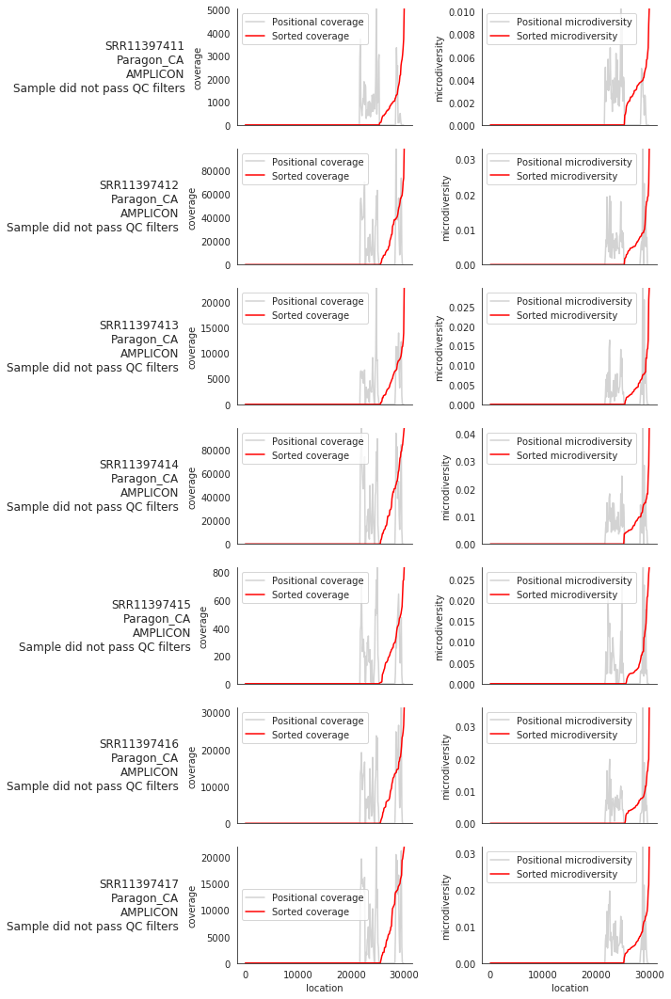

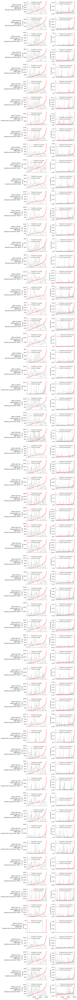

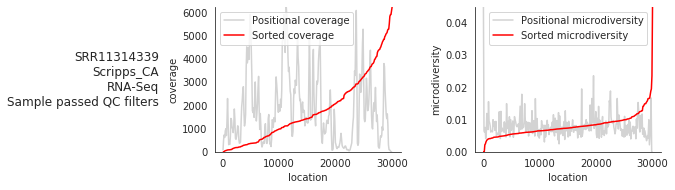

...

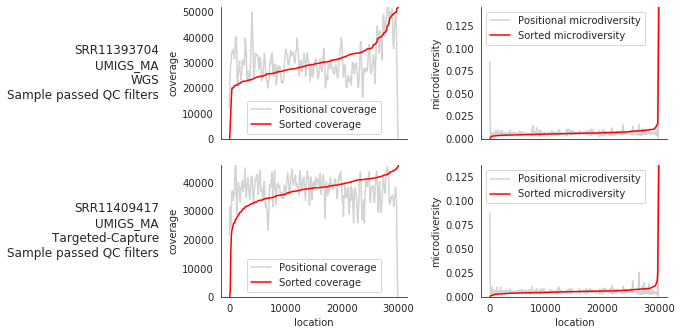

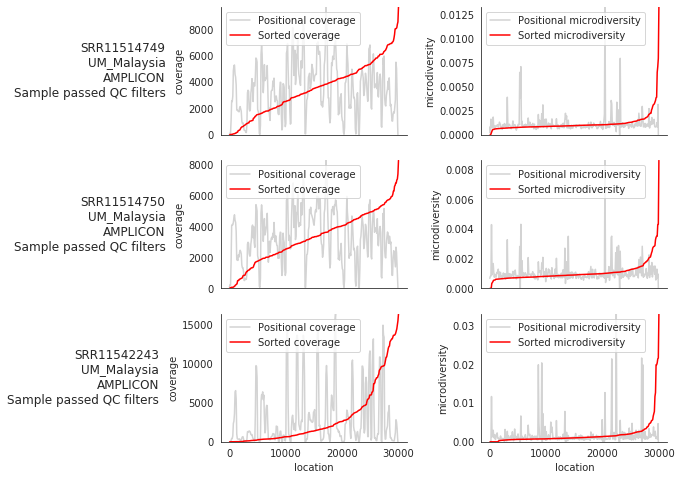

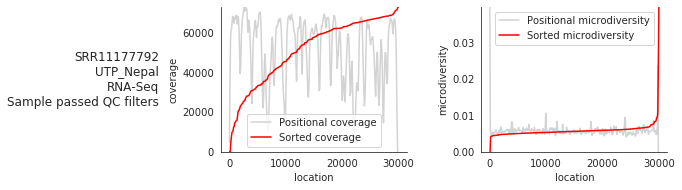

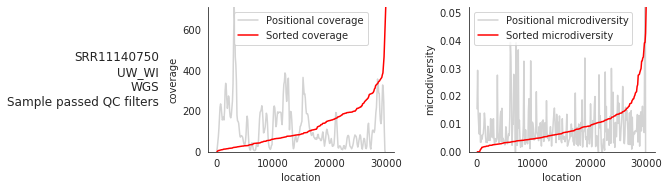

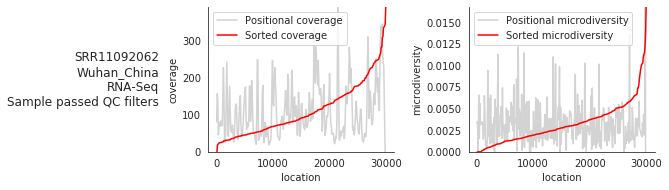

In [13]:
TRUE_LENGTH = 29903

def iterate_chunks_series(d, chunkSize=100, sLen=False):
    '''
    Break up Ndbs into chunks
    '''
    if sLen == False:
        sLen = d.index.max()

    numberChunks = sLen // chunkSize + 1
    for i in range(numberChunks):
        #print(i, int(i*chunkSize), int((i+1)*chunkSize), len(d))
        yield (d.loc[int(i*chunkSize):int((i+1)*chunkSize)])

def _gen_windowed_cov(cov, window_len, sLen=False, full_len=True):
    '''
    From a series of coverage values, return windows
    '''
    if sLen == False:
        sLen = cov.index.max()

    table = defaultdict(list)
    i = 0
    numberChunks = sLen // window_len + 1
    for cov in iterate_chunks_series(cov, chunkSize=window_len, sLen=sLen):
        if i + 1 == numberChunks:
            mLen = sLen - (i * window_len)
            if mLen == 0:
                continue
        else:
            mLen = window_len

        table['start'].append(i*window_len)
        table['end'].append(i*window_len + mLen)
        table['middle'].append(np.mean([i*window_len, i*window_len + mLen]))

        if full_len == True:
            table['avg_cov'].append(cov.sum() / mLen)
        elif full_len == False:
            table['avg_cov'].append(cov.mean())
        elif full_len == 'count':
            table['avg_cov'].append(len(cov)/mLen)
        i += 1

    return pd.DataFrame(table)

def distplot_special(fdb, ax1, ax2, name='name', window_width=100):#(fdb, PGdb, g2c, ax, XLIM, XNLIM, YLIM, YNLIM, center, rm_legend=True):
    pad=5
    
    # Make the plots
    for ax, thing in zip([ax1, ax2], ['coverage', 'microdiversity']):
    
        # Make the coverage on ax1
        Acov = fdb.set_index('position')[thing]
        Wcov = _gen_windowed_cov(Acov, window_width, sLen=TRUE_LENGTH)

        if len(Acov) == 0:
            ax1.set_axis_off()
            
        else:
            # Plot true coverage
            sns.lineplot(data=Wcov, x='middle', y='avg_cov', ax=ax, color='lightgrey', label='Positional {0}'.format(thing))

            # Plot sorted coverage
            Wcov['rank'] = Wcov['avg_cov'].rank(method='first')#.astype(int)
            Wcov['rank'] = Wcov['rank'] * window_width
            sns.lineplot(data=Wcov, x='rank', y='avg_cov', ax=ax, color='red', label='Sorted {0}'.format(thing))
            
            ax.set_ylim(0, Wcov['avg_cov'].max())
            ax.set_ylabel(thing)
            
    # Adjust the plots
    for ax in [ax1, ax2]:
        ax.set_xlabel('location')
        ax.spines['right'].set_visible(False)
        ax.spines['top'].set_visible(False)
        
    # Set label
    ax1.annotate(name, xy=(0, 0.5), xytext=(-ax.yaxis.labelpad - pad, 0),
                xycoords=ax1.yaxis.label, textcoords='offset points',
                size='large', ha='right', va='center')

# Set up data
FFdb = pd.merge(PLdb, Odb, on='Run').sort_values(['Center_ID', 'library_strategy'])
#Fdb = Fdb[Fdb['Run'].isin(list(Fdb['Run'].unique())[:3])]# == 'SRR11454606']
sns.set_style('white')

for center, Fdb in FFdb.groupby('Center_ID'):

    # Set up axes and figure
    cols = 2
    rows = int(len(Fdb['Run'].unique()))

    X_FIG_LEN = 8
    Y_FIG_LEN = (X_FIG_LEN/3 * rows)

    #print("{0} by {1}".format(cols, rows))
    fig, axs = plt.subplots(rows, cols, sharex=True, figsize=(X_FIG_LEN, Y_FIG_LEN), gridspec_kw={"wspace": 0.4, 'hspace':0.2})
    if rows == 1:
        axs = [axs]

    row = 0
    for run, db in Fdb.groupby('Run'):
        if run in FRUNS:
            fm = 'Sample passed QC filters'
        else:
            fm = 'Sample did not pass QC filters'
        
        distplot_special(db, ax1=axs[row][0], ax2=axs[row][1], name="{0}\n{2}\n{1}\n{3}".format(run, db['library_strategy'].tolist()[0], db['Center_ID'].tolist()[0], fm))
        row += 1

    try:
        plt.gcf().savefig(save_loc + 'distros/QC_Distributions_{0}_{1}.png'.format(DATE, center), bbox_inches='tight', dpi=200)
        plt.show()
    except:
        pass
    
# Set up data
FFdb = pd.merge(PLdb, Odb, on='Run').sort_values(['Center_ID', 'library_strategy'])
FFdb = FFdb[FFdb['Run'].isin(FRUNS)]
sns.set_style('white')

for center, Fdb in FFdb.groupby('Center_ID'):

    # Set up axes and figure
    cols = 2
    rows = int(len(Fdb['Run'].unique()))

    X_FIG_LEN = 8
    Y_FIG_LEN = (X_FIG_LEN/3 * rows)

    #print("{0} by {1}".format(cols, rows))
    fig, axs = plt.subplots(rows, cols, sharex=True, figsize=(X_FIG_LEN, Y_FIG_LEN), gridspec_kw={"wspace": 0.4, 'hspace':0.2})
    if rows == 1:
        axs = [axs]

    row = 0
    for run, db in Fdb.groupby('Run'):
        if run in FRUNS:
            fm = 'Sample passed QC filters'
        else:
            fm = 'Sample did not pass QC filters'
        
        distplot_special(db, ax1=axs[row][0], ax2=axs[row][1], name="{0}\n{2}\n{1}\n{3}".format(run, db['library_strategy'].tolist()[0], db['Center_ID'].tolist()[0], fm))
        row += 1

    try:
        plt.gcf().savefig(save_loc + 'distros/QC_Distributions_Passed_{0}_{1}.png'.format(DATE, center), bbox_inches='tight', dpi=200)
        plt.show()
    except:
        pass

# Set up positional microdiversity

In [14]:
# Mark regions
POdb['gene'] = POdb['ID'].map(Gdb.set_index('ID')['gene'].to_dict())
POdb['region'] = [1 if ((p >= 0) & (p < 13480)) else 2 if ((p >= 13480) & (p < 21560)) else 3 if ((p >= 21560)) else 0 for p in POdb['position']]
POdb[(POdb['coding'] == True) & (POdb['gene'] != 'orf1ab')]['region'].value_counts()

1    13255
2     8072
3     7974
Name: region, dtype: int64

In [15]:
fdb = pd.merge(Odb, POdb, on='position', how='left')
fdb = fdb[fdb['Run'].isin(FRUNS)]
fdb = fdb[~fdb['orf_position'].isna()]
fdb['orf_position'] = fdb['orf_position'].astype(int)

fdb = pd.merge(fdb, Gdb[['ID', 'product', 'gene']], how='left', on='ID')
fdb = pd.merge(fdb, PLdb[['Run', 'Center_ID', 'Method']], how='left', on='Run')

PFdb = PFdb[(PFdb['coding'] == True) & (PFdb['gene'] != 'orf1ab')]

NameError: name 'PFdb' is not defined

## Calculate codon bias per sample

In [ ]:
ON = 'normalized_microdiversity'

table = defaultdict(list)
for r, db in PFdb.groupby('Run'):
#     sns.barplot(data=db, x='orf_position', y=ON)#, ci=None)#, showfliers=False)
#     #plt.ylim(0.00145, 0.00154)
#     plt.xlabel('Codon position')
#     plt.ylabel('Nucleotide diversity (π)')
#     plt.title(c)
#     plt.show()
    ORIdb = db
    for ON in ['normalized_microdiversity', 'microdiversity']:
        region = 'all'
        
        table['Run'].append(r)
        table['region'].append(region)
        table['value'].append(ON)
        table['0_1_p'].append(scipy.stats.ranksums(db[db['orf_position'] == 0][ON], db[db['orf_position'] == 1][ON])[1])
        table['01_2_p'].append(scipy.stats.ranksums(db[db['orf_position'] != 2][ON], db[db['orf_position'] == 2][ON])[1])
        table['0/1'].append(db[db['orf_position'] == 0][ON].mean()/db[db['orf_position'] == 1][ON].mean())
        table['2/01'].append(db[db['orf_position'] == 2][ON].mean()/db[db['orf_position'] != 2][ON].mean())
        
        for region, db in ORIdb.groupby('region'):
            table['Run'].append(r)
            table['region'].append(region)
            table['value'].append(ON)
            table['0_1_p'].append(scipy.stats.ranksums(db[db['orf_position'] == 0][ON], db[db['orf_position'] == 1][ON])[1])
            table['01_2_p'].append(scipy.stats.ranksums(db[db['orf_position'] != 2][ON], db[db['orf_position'] == 2][ON])[1])
            table['0/1'].append(db[db['orf_position'] == 0][ON].mean()/db[db['orf_position'] == 1][ON].mean())
            table['2/01'].append(db[db['orf_position'] == 2][ON].mean()/db[db['orf_position'] != 2][ON].mean())
         
        for region, db in ORIdb.groupby('gene'):
            table['Run'].append(r)
            table['region'].append(region)
            table['value'].append(ON)
            table['0_1_p'].append(scipy.stats.ranksums(db[db['orf_position'] == 0][ON], db[db['orf_position'] == 1][ON])[1])
            table['01_2_p'].append(scipy.stats.ranksums(db[db['orf_position'] != 2][ON], db[db['orf_position'] == 2][ON])[1])
            table['0/1'].append(db[db['orf_position'] == 0][ON].mean()/db[db['orf_position'] == 1][ON].mean())
            table['2/01'].append(db[db['orf_position'] == 2][ON].mean()/db[db['orf_position'] != 2][ON].mean())

RIdb = pd.DataFrame(table)
RIdb = pd.merge(RIdb, PLdb[['Run', 'Center_ID', 'Method']], how='left', on='Run')
RIdb['proper_bias'] = [((p <= 0.05) & (r > 1)) for p, r in zip(RIdb['01_2_p'], RIdb['2/01'])]
RIdb['improper_bias'] = [((p <= 0.05) & (r < 1)) for p, r in zip(RIdb['01_2_p'], RIdb['2/01'])]
    

## Save

In [ ]:
RIdb['sig_proper_bias'] = [((p <= 0.05) & (r > 1)) for p, r in zip(RIdb['01_2_p'], RIdb['2/01'])]
RIdb['sig_improper_bias'] = [((p <= 0.05) & (r < 1)) for p, r in zip(RIdb['01_2_p'], RIdb['2/01'])]
RIdb['proper_bias'] = [((r > 1)) for p, r in zip(RIdb['01_2_p'], RIdb['2/01'])]
RIdb['improper_bias'] = [((r < 1)) for p, r in zip(RIdb['01_2_p'], RIdb['2/01'])]
#RIdb.to_csv(saveloc + 'codonbias_v2.2.csv', index=False)

## Patterns of codon bias

Proper bias means significant in the right direction

Improper bias mean significant in the wrong direction

In [ ]:
for c, db in RIdb[(RIdb['region'] == 'all') & (RIdb['value'] == 'normalized_microdiversity')].groupby('Center_ID'):
    s = len(db)
    p = len(db[db['sig_proper_bias'] == True])
    i = len(db[db['sig_improper_bias'] == True])
    print("{0:20}: {1:3} samples, {2:5.1f}% proper bias ({4:3} in {1:3}), {3:5.1f}% improper bias ({5:3} in {1:3})".format(
        c, s, (p/s)*100, (i/s)*100, p, i))

In [ ]:
for c, db in RIdb[(RIdb['region'] == 'all') & (RIdb['value'] == 'normalized_microdiversity')].groupby('Center_ID'):
    s = len(db)
    p = len(db[db['proper_bias'] == True])
    i = len(db[db['improper_bias'] == True])
    print("{0:20}: {1:3} samples, {2:5.1f}% proper bias ({4:3} in {1:3}), {3:5.1f}% improper bias ({5:3} in {1:3})".format(
        c, s, (p/s)*100, (i/s)*100, p, i))

# Statistics

In [ ]:
tdb = RIdb[(RIdb['region'] == 'all') & (RIdb['value'] == 'normalized_microdiversity')]
tdb['Method'].value_counts()

In [ ]:
tdb = RIdb[(RIdb['region'] == 'all') & (RIdb['value'] == 'normalized_microdiversity')]
for m, db in tdb.groupby('Method'):
    num_sig = len(db[(db['sig_proper_bias'] == True) | (db['sig_improper_bias'] == True)])
    num_imp = len(db[(db['sig_improper_bias'] == True)])
    num_pro = len(db[(db['sig_proper_bias'] == True)])
    p = scipy.stats.binom_test([num_imp, num_pro])
    if ((num_sig > 0) & (p < 0.05)):
        print("{0:20} has {1:3} samples, {2:3} sig samples, {3:5.1f}% of sig samples are in proper codon bias, (p = {4:.5f})".format(m, len(db), num_sig, (num_pro/num_sig)*100, p))

In [ ]:
tdb = RIdb[(RIdb['region'] == 'all') & (RIdb['value'] == 'normalized_microdiversity')]
for m, db in tdb.groupby('Center_ID'):
    num_sig = len(db[(db['sig_proper_bias'] == True) | (db['sig_improper_bias'] == True)])
    num_imp = len(db[(db['sig_improper_bias'] == True)])
    num_pro = len(db[(db['sig_proper_bias'] == True)])
    p = scipy.stats.binom_test([num_imp, num_pro])
    if ((num_sig > 0) & (p < 0.05)):
        print("{0:20} has {1:3} samples, {2:3} sig samples, {3:5.1f}% of sig samples are in proper codon bias, (p = {4:.5f})".format(m, len(db), num_sig, (num_pro/num_sig)*100, p))

# Look for comonalities amoung improper samples

I want to say that these samples are garbage but need more evidence. What other signals could there be?

* dN/dS? (too variable of a singnal)

* Lack of consistancy in which genes have the highest / lowest microdiversity?

## On a gene level what do you see?

In [ ]:
Xdb = RIdb[(RIdb['value'] == 'normalized_microdiversity')]
table = defaultdict(list)
for r, db in Xdb.groupby('region'):
    table['region'].append(r)
    table['percent_improper'].append((len(db[db['improper_bias'] == True])/len(db))*100)
    table['percent_proper'].append((len(db[db['proper_bias'] == True])/len(db))*100)
    table['percent_sig_improper'].append((len(db[db['sig_improper_bias'] == True])/len(db))*100)
    table['percent_sig_proper'].append((len(db[db['sig_proper_bias'] == True])/len(db))*100)
    
    num_sig = len(db[(db['sig_proper_bias'] == True) | (db['sig_improper_bias'] == True)])
    num_imp = len(db[(db['sig_improper_bias'] == True)])
    num_pro = len(db[(db['sig_proper_bias'] == True)])
    p = scipy.stats.binom_test([num_imp, num_pro])
    if ((num_sig > 0) & (p < 0.05)):
        print("{0:20} has {1:3} samples, {2:3} sig samples, {3:5.1f}% of sig samples are in proper codon bias, (p = {4:.2E})".format(r, len(db), num_sig, (num_pro/num_sig)*100, p))
    
    #print("region {0} {1:.1f}% improper".format(r, (len(db[db['improper_bias'] == True])/len(db))*100))
tdb = pd.DataFrame(table).sort_values('percent_sig_proper')

sns.scatterplot(data=tdb, x='percent_sig_proper', y='percent_sig_improper')
plt.plot([0,40], [0,40], ls='--', c='black')
plt.show()

tdb

In [ ]:
Xdb = RIdb[(RIdb['value'] == 'normalized_microdiversity') & (RIdb['Method'] == 'RNA-seq')]
table = defaultdict(list)
for r, db in Xdb.groupby('region'):
    table['region'].append(r)
    table['percent_improper'].append((len(db[db['improper_bias'] == True])/len(db))*100)
    table['percent_proper'].append((len(db[db['proper_bias'] == True])/len(db))*100)
    table['percent_sig_improper'].append((len(db[db['sig_improper_bias'] == True])/len(db))*100)
    table['percent_sig_proper'].append((len(db[db['sig_proper_bias'] == True])/len(db))*100)
    #print("region {0} {1:.1f}% improper".format(r, (len(db[db['improper_bias'] == True])/len(db))*100))
tdb = pd.DataFrame(table).sort_values('percent_sig_proper')

sns.scatterplot(data=tdb, x='percent_sig_proper', y='percent_sig_improper')
plt.plot([0,40], [0,40], ls='--', c='black')
plt.show()

tdb

## Focus on overall improper samples

* Seems to be driven by genome-wide signals, not just a single gene or region

In [ ]:
IMPROPER = set(RIdb[(RIdb['region'] == 'all') & (RIdb['value'] == 'normalized_microdiversity') & (RIdb['sig_improper_bias'] == True)]['Run'].tolist())
Xdb = RIdb[(RIdb['value'] == 'normalized_microdiversity') & (RIdb['Run'].isin(IMPROPER))]
for r, db in Xdb.groupby('region'):
    print("region {0:30} {1:4.1f}% improper {2:4.1f}% proper".format(r, (len(db[db['sig_improper_bias'] == True])/len(db))*100, len(db[db['sig_proper_bias'] == True])/len(db)*100))
# table = defaultdict(list) 
# for run, db in Xdb.groupby('Run'):
#     table['run'].append(run)
#     table['all'].append(db[db['region'] == 'all']['improper_bias'].tolist()[0])
#     for r, dn

In [ ]:
for c, xdb in RIdb[RIdb['value'] == 'normalized_microdiversity'].groupby('Center_ID'):
    s = len(db)
    i = len(db[db['improper_bias'] == True])
    print("{0:20}: {1:3} samples, {2:5.1f}% proper bias ({4:3} in {1:3}), {3:5.1f}% improper bias ({5:3} in {1:3})".format(
        c, s, (p/s)*100, (i/s)*100, p, i))

# Is it associated with date of collection?

In [ ]:
fdb = pd.merge(PLdb, RIdb, on=['Run', 'Center_ID', 'Method'], how='inner')
fdb['collection_date'] = pd.to_datetime(fdb['collection_date'])
fdb['release_date'] = [datetime.datetime.fromtimestamp(x) for x in fdb['release_date']]
fdb = fdb[~fdb['collection_date'].isna()]
fdb = fdb[fdb['collection_date'] > pd.to_datetime("2019-01-19")]
Fdb = fdb.copy()

for TITLE in ['PublicHealth_UT', 'Doherty_Melbourne']:
    fdb = Fdb[Fdb['Center_ID'] == TITLE]
    
    sns.distplot(fdb[fdb['proper_bias'] == True]['collection_date'], kde=True, hist=False, rug=True, kde_kws={'bw':1e14}, label='Proper')
    sns.distplot(fdb[fdb['proper_bias'] == False]['collection_date'], kde=True, hist=False, rug=True, kde_kws={'bw':1e14}, label='Not proper')
    plt.title(TITLE)
    plt.show()
    
    sns.distplot(fdb[fdb['improper_bias'] == True]['collection_date'], kde=True, hist=False, rug=True, kde_kws={'bw':1e14}, label='Improper')
    sns.distplot(fdb[fdb['improper_bias'] == False]['collection_date'], kde=True, hist=False, rug=True, kde_kws={'bw':1e14}, label='Not improper')
    plt.title(TITLE)
    plt.show()

# fdb[fdb['proper_bias'] == True]

# Is it the same for the begining and end of the genome?

In [ ]:
ON = 'normalized_microdiversity'

table = defaultdict(list)
for r, db in fdb.groupby('Run'):
#     sns.barplot(data=db, x='orf_position', y=ON)#, ci=None)#, showfliers=False)
#     #plt.ylim(0.00145, 0.00154)
#     plt.xlabel('Codon position')
#     plt.ylabel('Nucleotide diversity (π)')
#     plt.title(c)
#     plt.show()
    
    # Do it for the whole genome
    AREA = 'all'
    table['Run'].append(r)
    table['area'].append(AREA)
    table['0_1_p'].append(scipy.stats.ranksums(db[db['orf_position'] == 0][ON], db[db['orf_position'] == 1][ON])[1])
    table['01_2_p'].append(scipy.stats.ranksums(db[db['orf_position'] != 2][ON], db[db['orf_position'] == 2][ON])[1])
    table['0/1'].append(db[db['orf_position'] == 0][ON].mean()/db[db['orf_position'] == 1][ON].mean())
    table['2/01'].append(db[db['orf_position'] == 2][ON].mean()/db[db['orf_position'] != 2][ON].mean())
    
    # Do it for halves of the genome
    AREA

RIdb = pd.DataFrame(table)
RIdb = pd.merge(RIdb, PLdb[['Run', 'Center_ID', 'Method']], how='left', on='Run')

#             stat, p = scipy.stats.ranksums(fdb[fdb['orf_position'] == orf1][ON].tolist(), fdb[fdb['orf_position'] == orf2][ON].tolist())
#             print("{0} vs {1} - p = {2:.2E}".format(orf1 + 1, orf2 + 1, p))
    

## 1) QC to show that overall, the third position has higher microdiversity. Also choose a metric

I Think I like normalized_microdiversity

In [ ]:
fdb = PFdb.copy()
fdb = fdb.drop_duplicates(subset=['Run', 'position'])

for ON in ['coverage', 'microdiversity', 'normalized_microdiversity',	'rarefied_microdiversity',	'normalized_rarefied_microdiversity']:
    print("!!! {0} !!!".format(ON))
    for i, orf1 in enumerate([0, 1, 2]):
        for j, orf2 in enumerate([0, 1, 2]):
            if i >= j:
                continue
            stat, p = scipy.stats.ranksums(fdb[fdb['orf_position'] == orf1][ON].tolist(), fdb[fdb['orf_position'] == orf2][ON].tolist())
            print("{0} vs {1} - p = {2:.2E}".format(orf1 + 1, orf2 + 1, p))
    print()

In [ ]:
fdb = PFdb.copy()
fdb = fdb[fdb['Method'] == 'RNA-seq']
fdb = fdb.drop_duplicates(subset=['Run', 'position'])

for ON in ['coverage', 'microdiversity', 'normalized_microdiversity',	'rarefied_microdiversity',	'normalized_rarefied_microdiversity']:
    print("!!! {0} !!!".format(ON))
    for i, orf1 in enumerate([0, 1, 2]):
        for j, orf2 in enumerate([0, 1, 2]):
            if i >= j:
                continue
            stat, p = scipy.stats.ranksums(fdb[fdb['orf_position'] == orf1][ON].tolist(), fdb[fdb['orf_position'] == orf2][ON].tolist())
            print("{0} vs {1} - p = {2:.2E}".format(orf1 + 1, orf2 + 1, p))
    print()

In [ ]:
ON = 'normalized_microdiversity'
MIN_COV = 50

fdb = PFdb.copy()
fdb = fdb.drop_duplicates(subset=['Run', 'position'])

sns.barplot(data=fdb, x='orf_position', y=ON)#, ci=None)#, showfliers=False)
plt.ylim(0.00145, 0.00154)
plt.xlabel('Codon position')
plt.ylabel('Nucleotide diversity (π)')

for i, orf1 in enumerate([1, 2, 3]):
    for j, orf2 in enumerate([1, 2, 3]):
        if i >= j:
            continue
        stat, p = scipy.stats.ranksums(fdb[fdb['orf_position'] == orf1][ON].tolist(), fdb[fdb['orf_position'] == orf2][ON].tolist())
        print("{0} vs {1} - p = {2:.2E}".format(orf1, orf2, p))
plt.title('Normalized nucleotide diversity at different codon positions (min {0}x coverage; {1} samples)'.format(MIN_COV, len(fdb['Run'].unique())))
#plt.gcf().savefig(save_loc + 'CodonNormMicrodiversity_min_{0}_v3.png'.format(MIN_COV), bbox_inches='tight', dpi=200)
plt.gcf().savefig(save_loc + 'CodonNormMicrodiversity_min_{0}_{1}.png'.format(MIN_COV, DATE), bbox_inches='tight', dpi=200)

plt.show()

        

In [ ]:
fdb

In [ ]:
sns.barplot(data=fdb, x='orf_position', y=ON)#, ci=None)#, showfliers=False)
#plt.ylim(0.00145, 0.00154)
plt.xlabel('Codon position')
plt.ylabel('Nucleotide diversity (π)')
plt.show()

## On the gene level

In [ ]:
ON = 'normalized_microdiversity'
MIN_COV = 50

fdb = PFdb.copy()

sns.barplot(data=fdb, x='product', y=ON, hue='orf_position')#, ci=None)#, showfliers=False)
#plt.ylim(0.00145, 0.00154)
plt.xlabel('Codon position')
plt.ylabel('Nucleotide diversity (π)')
plt.xticks(rotation=90)

plt.gcf().set_size_inches(12, 4)
plt.show()

# Make a table for all genes

In [ ]:
IPdb = pd.read_csv('/home/mattolm/user_data/GitRepos/covid19_population_genomics/data/interpatient/nucleotide_diversity.txt', sep='\t', names=['position', 'diversity'])
IPdb['position'] = IPdb['position'] - 1
IPdb.head()

In [ ]:
# Rank nucleotide diversity

ON = 'diversity'
rdb = pd.merge(IPdb, POdb, how='left', on='position')
table = defaultdict(list)
for gene, db in rdb.groupby('ID'):
    #table['Run'].append(run)
    table['gene'].append(gene)
    table[ON].append(db[ON].mean())

PGdb = pd.DataFrame(table)
PGdb['{0}_rank'.format(ON)] = PGdb[ON].rank(method='min').astype(int)
i2d = PGdb.set_index('gene')['diversity_rank'].to_dict()
PGdb.head()


In [ ]:
fdb = pd.merge(Odb, POdb, on='position', how='left').merge(COdb, how='left', on='Run')
fdb['product'] = fdb['ID'].map(Gdb.set_index('ID')['product'].to_dict())
fdb['gene'] = fdb['ID'].map(Gdb.set_index('ID')['gene'].to_dict())
fdb = fdb[fdb['Run'].isin(FRUNS)]
fdb = fdb[~fdb['orf_position'].isna()]
fdb['orf_position'] = fdb['orf_position'].astype(int)
fdb = pd.merge(fdb, IPdb, how='left', on='position')

PFdb = fdb
PFdb.head()

In [ ]:
Gdb['length'] = Gdb['end'] - Gdb['start']
i2g = Gdb.set_index('ID')['gene'].to_dict()
i2t = Gdb.set_index('ID')['translated'].to_dict()
i2l = Gdb.set_index('ID')['length'].to_dict()

In [ ]:
table = defaultdict(list)
for id, db in MFdb.groupby('gene'):
    table['ID'].append(id)
    table['gene'].append(i2g[id])
    table['translated'].append(i2t[id])
    table['length'].append(i2l[id])
    for i in ['normalized_microdiversity', 'normalized_microdiversity_rank', 'coverage_rank']:
        table['avg_{0}'.format(i)].append(db[i].mean())
        
    # if translated
    ON = 'normalized_microdiversity'
    cdb = PFdb[PFdb['ID'] == id]
    if i2t[id]:
        t = cdb[cdb['orf_position'] == 2][ON]
        nt = cdb[cdb['orf_position'] != 2][ON]
        stat, p = scipy.stats.ranksums(t, nt)
        
        if id == 'YP_009725312.1':
            print(len(t))
            print(len(nt))
        
        table['codon_bias'].append(np.mean(t)/ np.mean(nt))
        table['codon_p'].append(p)
        table['codon_stat'].append(stat)
    else:
        table['codon_bias'].append(np.nan)
        table['codon_p'].append(np.nan)
        table['codon_stat'].append(stat)
        
    # Handle inter-diversity
    table['avg_inter_diversity'].append(cdb['diversity'].mean())
    table['inter_diversity_rank'].append(i2d[id])
    ON = 'diversity'
    if i2t[id]:
        t = cdb[cdb['orf_position'] == 2][ON]
        nt = cdb[cdb['orf_position'] != 2][ON]
        stat, p = scipy.stats.ranksums(t, nt)
        
        table['inter_codon_bias'].append(np.mean(t)/ np.mean(nt))
        table['inter_codon_p'].append(p)
        table['inter_codon_stat'].append(stat)
    else:
        table['inter_codon_bias'].append(np.nan)
        table['inter_codon_p'].append(np.nan)
        table['inter_codon_stat'].append(stat)

IGdb = pd.DataFrame(table)
IGdb = pd.merge(IGdb, Gdb[['ID', 'type']], on='ID', how='left')

In [ ]:
IGdb.sort_values('codon_bias')

## Plots

In [ ]:
pal = {'other':'grey', 'nsp11':'red', 'ORF10':'orange', 'nsp10':'green', 'nsp8':'purple'}
pal = {'other':'grey', 'nsp11':'red', 'ORF10':'orange'}

In [ ]:
fdb = IGdb.copy()

fdb['name'] = [g if g in pal else 'other' for g in fdb['gene']]

sns.set_style('white')
sns.scatterplot(data=fdb, x='inter_diversity_rank', y='avg_normalized_microdiversity_rank', hue='name', palette=pal, s=100, edgecolor='black')
plt.gca().legend(loc='lower center', ncol=3, title='Gene Type', bbox_to_anchor= (0.5, -0.5))
plt.xlabel('Inter-patient diversity')
plt.ylabel('Intra-patient diversity')
plt.xlim(0, 30)
plt.ylim(0, 30)
plt.show()

In [ ]:
fdb = IGdb.copy()

fdb['name'] = [g if g in pal else 'other' for g in fdb['gene']]

sns.set_style('white')
sns.scatterplot(data=fdb[fdb['translated'] == True], y='avg_normalized_microdiversity_rank', x='codon_bias', 
                hue='name', s=100, edgecolor='black', palette=pal)
plt.gca().legend(loc='lower center', ncol=3, title='Gene Type', bbox_to_anchor= (0.5, -0.5))
plt.ylabel('Average intra-patient diversity (rank)')
plt.xlabel('Diveristy at 3rd codon position \n{0}\n Diversity at 1st and 2nd codon position'.format('-'*45))
plt.axvline(1, ls='--')
#plt.xlim(0, 30)
#plt.ylim(0, 30)
plt.show()

In [ ]:
fdb = IGdb.copy()

fdb['name'] = [g if g in pal else 'other' for g in fdb['gene']]

sns.set_style('white')
sns.scatterplot(data=fdb[fdb['translated'] == True], x='length', y='codon_p', 
                hue='name', s=100, edgecolor='black', palette=pal)
plt.gca().legend(loc='lower center', ncol=3, title='Gene Type', bbox_to_anchor= (0.5, -0.5))
plt.yscale('log')
plt.xscale('log')
plt.axhline(0.05, ls='--')
plt.ylim(1e-10, 1)
plt.xlim(0,5000)
# plt.ylabel('Average intra-patient diversity (rank)')
# plt.xlabel('Diveristy at 3rd codon position \n{0}\n Diversity at 1st and 2nd codon position'.format('-'*45))
# plt.axvline(1, ls='--')
#plt.xlim(0, 30)
#plt.ylim(0, 30)
plt.show()

# Gene plot for nsp11

In [ ]:
fdb = Ndb[Ndb['gene'] == 'RNA-dependent RNA polymerase'].drop_duplicates(subset=['position']).sort_values('position')

In [ ]:
Ndb =  pd.merge(POdb, Gdb[['ID', 'gene', 'product', 'type']], on='ID', how='left')
Ndb = Ndb[(Ndb['position'].isin(Ndb[Ndb['gene'] == 'nsp11']['position'])) & (Ndb['type'] == 'mat_peptide')].sort_values(['position', 'gene']).dropna()
Ndb = pd.merge(Ndb, odb, on='position', how='left')

#fdb = Ndb.drop_duplicates(subset=['position']).sort_values('position')
for g in ['nsp11', 'RNA-dependent RNA polymerase']:
    fdb = Ndb[Ndb['gene'] == g]#.drop_duplicates(subset=['position']).sort_values('position')
    sns.barplot(data=fdb, x='position', y='normalized_microdiversity', hue='orf_position', dodge=False)
    plt.xticks(rotation=90)
    plt.title(g)
    plt.axvline(26, ls='--')
    plt.show()

In [ ]:
ON = 'normalized_microdiversity'

sns.set_style('white')

odb = Odb[Odb['Run'].isin(FRUNS)].groupby('position')[ON].mean().to_frame().reset_index()

Ndb =  pd.merge(POdb, Gdb[['ID', 'gene', 'product', 'type']], on='ID', how='left')
Ndb = Ndb[(Ndb['position'].isin(Ndb[Ndb['gene'] == 'nsp11']['position'])) & (Ndb['type'] == 'mat_peptide')].sort_values(['position', 'gene']).dropna()
Ndb = pd.merge(Ndb, odb, on='position', how='left')

#fdb = Ndb.drop_duplicates(subset=['position']).sort_values('position')
for g in ['nsp11', 'RNA-dependent RNA polymerase']:
    fdb = Ndb[Ndb['gene'] == g]#.drop_duplicates(subset=['position']).sort_values('position')
    fdb['aa_index'] = fdb['aa_index'].astype(int)
    fdb = fdb[fdb['aa_index'] <= 12]
    sns.barplot(data=fdb, x='aa_index', y=ON, hue='orf_position', dodge=True)
    #plt.xticks(rotation=90)
    plt.title(g)
    plt.axvline(8, ls='--', c='black')
    plt.xlabel('Amino acid index')
    plt.ylabel('Nucleotide diversity (pi)')
    plt.gca().get_legend().remove()
    plt.gca().spines['right'].set_visible(False)
    plt.gca().spines['top'].set_visible(False)
    plt.gcf().set_size_inches(5, 2)
    plt.gcf().savefig(save_loc + 'nsp11_{1}_{2}.png'.format(0, DATE, g), bbox_inches='tight', dpi=200)
    plt.show()

In [ ]:
odb = Odb[Odb['Run'].isin(FRUNS)].groupby('position')[ON].mean().to_frame().reset_index()
Ndb =  pd.merge(POdb, Gdb[['ID', 'gene', 'product', 'type']], on='ID', how='left')
odb = pd.merge(odb, Ndb, how='left', on='position')
odb[odb['type'] == 'mat_peptide'].sort_values('normalized_microdiversity').head(20)

In [ ]:
odb[odb['type'] == 'mat_peptide'].sort_values('normalized_microdiversity', ascending=False).head(20)

# Is the signal really there with nsp11?

In [ ]:
odb = Odb[Odb['Run'].isin(FRUNS)]# & (Odb['position'].isin(Ndb[Ndb['gene'] == 'nsp11']['position']))]
Ndb =  pd.merge(POdb, Gdb[['ID', 'gene', 'product', 'type']], on='ID', how='left')
odb = pd.merge(odb, Ndb, how='left', on='position')
odb = odb[odb['gene'] == 'nsp11']

MAX = 0.01
odb = odb[odb['normalized_microdiversity'] <= MAX]
sns.distplot(odb[odb['orf_position'] == 0]['normalized_microdiversity'], label='orf 0', bins=10)
sns.distplot(odb[odb['orf_position'] == 1]['normalized_microdiversity'], label='orf 1', bins=10)
sns.distplot(odb[odb['orf_position'] == 2]['normalized_microdiversity'], label='orf 2', bins=10)
#plt.xscale('log')
plt.xlim(0, MAX)
plt.legend()
plt.show()

In [ ]:
odb = Odb[Odb['Run'].isin(FRUNS) & (Odb['position'].isin(Ndb[Ndb['gene'] == 'nsp11']['position']))]
Ndb =  pd.merge(POdb, Gdb[['ID', 'gene', 'product', 'type']], on='ID', how='left')
odb = pd.merge(odb, Ndb, how='left', on='position')
odb = odb[odb['gene'] == 'nsp11']

# MAX = 0.01
# odb = odb[odb['normalized_microdiversity'] <= MAX]
sns.boxplot(data=odb, x='orf_position', y='normalized_microdiversity', showfliers=False)
#plt.xscale('log')
#plt.xlim(0, MAX)
plt.legend()
plt.show()

ON = 'normalized_microdiversity'
t = odb[odb['orf_position'] == 2][ON]
nt = odb[odb['orf_position'] != 2][ON]
stat, p = scipy.stats.ranksums(t, nt)

# stat, p = scipy.stats.ranksums(odb[odb['orf_position'] == 2][ON], fdb[fdb['orf_position'] != 2][ON])
# print(len(odb[odb['orf_position'] == 2][ON].tolist()))
# print(len(odb[odb['orf_position'] != 2][ON].tolist()))
print("{0} vs {1} - p = {2:.2E}".format('2', 'not 2', p))

In [ ]:
ON = 'normalized_microdiversity'
stat, p = scipy.stats.ttest_ind(odb[odb['orf_position'] == 2][ON], odb[odb['orf_position'] != 2][ON], nan_policy='omit')
print(len(odb[odb['orf_position'] == 2][ON].tolist()))
print(len(odb[odb['orf_position'] != 2][ON].tolist()))
print("{0} vs {1} - p = {2:.2E}".format('2', 'not 2', p))

ON = 'normalized_microdiversity'
stat, p = scipy.stats.ranksums(odb[odb['orf_position'] == 2][ON].dropna(), odb[odb['orf_position'] != 2][ON].dropna())#, nan_policy='omit')
print(len(odb[odb['orf_position'] == 2][ON].tolist()))
print(len(odb[odb['orf_position'] != 2][ON].tolist()))
print("{0} vs {1} - p = {2:.2E}".format('2', 'not 2', p))

np.mean(t) / np.mean(nt)

## 2) Identify genes with consistantly high / low microdiversity

In [ ]:
## Plot
fdb = MGdb[MGdb['Run'].isin(FRUNS)]
fdb['name'] = fdb['gene'].map(Gdb.set_index('ID')['gene'].to_dict())
ITEMS = ['normalized_microdiversity', 'coverage']

# Get the sort order
order = fdb.groupby('name')['normalized_microdiversity_rank'].mean().to_frame().sort_values('normalized_microdiversity_rank').reset_index()['name'].tolist()

# Melt
fdb = fdb.melt(id_vars=['name', 'Run'], value_vars=[i + '_rank' for i in ITEMS])
fdb = fdb[fdb['Run'] != 'all']

# Sort
fdb['name'] = fdb['name'].astype('category')
fdb['name'].cat.reorder_categories(order, inplace=True)
fdb = fdb.sort_values('name')

# Rename
v2v = {'normalized_microdiversity_rank':'Nucleotide diversity (π)', 'coverage_rank':'Coverage'}
fdb['variable'] = fdb['variable'].map(v2v)

# Plot
fdb = fdb[fdb['variable'] == 'Nucleotide diversity (π)']
sns.barplot(data=fdb, x='name', y='value', color='grey')#, ci=None)
plt.xticks(rotation=90)
plt.xlabel('Gene')
plt.ylabel("Average rank order Nucleotide diversity (π)\n(Average of {0} samples)".format(len(fdb['Run'].unique())))
#plt.legend(title='')
plt.gcf().set_size_inches(7, 4)
#plt.gcf().savefig(save_loc + 'GeneMicrodiversity_RankOrder_v2.png'.format(MIN_COV), bbox_inches='tight', dpi=200)
plt.gcf().savefig(save_loc + 'GeneMicrodiversity_RankOrder_{0}.png'.format(DATE), bbox_inches='tight', dpi=200)
plt.show()


# Incorporate interpatient nucleotide diversity

In [ ]:
IPdb

In [ ]:
## Plot
fdb = MGdb[MGdb['Run'].isin(FRUNS)]
ITEMS = ['normalized_microdiversity', 'coverage']

g2n = {}
for g, n in dict(POdb.set_index('protein')['protein_name'].to_dict()).items():
    g2n[g] = n
for g, n in dict(POdb.set_index('gene')['gene_name'].to_dict()).items():
    g2n[g] = n

fdb['name'] = fdb['gene'].map(g2n)

# Get the sort order
order = fdb.groupby('name')['normalized_microdiversity_rank'].mean().to_frame().sort_values('normalized_microdiversity_rank').reset_index()['name'].tolist()

# Melt
fdb = fdb.melt(id_vars=['name', 'Run'], value_vars=[i + '_rank' for i in ITEMS])
fdb = fdb[fdb['Run'] != 'all']

# Add interpatient diversity
ffdb = PGdb.copy()
ffdb['name'] = ffdb['gene'].map(g2n)
ffdb['variable'] = 'Inter-patient nucleotide diversity (π)'
ffdb = ffdb[['name', 'variable', 'diversity_rank']].rename(columns={'diversity_rank':'value'})
fdb = pd.concat([fdb, ffdb])

# Sort
fdb['name'] = fdb['name'].astype('category')
fdb['name'].cat.reorder_categories(order, inplace=True)
fdb = fdb.sort_values('name')

# Rename
v2v = {'normalized_microdiversity_rank':'Intra-patient nucleotide diversity (π)', 'coverage_rank':'Coverage', 'Inter-patient nucleotide diversity (π)':'Inter-patient nucleotide diversity (π)'}
fdb['variable'] = fdb['variable'].map(v2v)

# Remove coverage
fdb = fdb[fdb['variable'] != 'Coverage']

# Plot
sns.barplot(data=fdb, x='name', y='value', hue='variable')#, ci=None)
plt.xticks(rotation=90)
plt.xlabel('Gene')
plt.ylabel("Average rank order Nucleotide diversity (π)\n(Average of {0} samples)".format(len(fdb['Run'].unique())))
plt.legend(title='')
plt.gcf().set_size_inches(10, 4)
#plt.gcf().savefig(save_loc + 'GeneMicrodiversity_RankOrder_interIntra_v2.png'.format(MIN_COV), bbox_inches='tight', dpi=200)
plt.gcf().savefig(save_loc + 'GeneMicrodiversity_RankOrder_interIntra_{0}.png'.format(DATE), bbox_inches='tight', dpi=200)
plt.show()


# Scatter plot

## By center ID

In [ ]:
Fdb = MGdb[MGdb['Run'].isin(FRUNS)]
Fdb = Fdb[Fdb['Run'] != 'all']
Fdb = pd.merge(Fdb, PLdb[['Run', 'Center_ID']], on='Run')
Fdb = Fdb[Fdb['Run'].isin(FRUNS)]

LIM = 0.004
NLIM = -0.0001

g2c = {'S':'Spike', 'ORF10':'ORF10', 'ORF8':'ORF8', 'stem_loop':'stem_loop', "YP_009725312.1":'nsp11', 'ORF6':'ORF6', '5\'UTR':'UTR'}


# Set up axes
X_LEN = 3
Y_LEN = int((len(Fdb['Center_ID'].unique()) + 2) / X_LEN)
print("{0} by {1}".format(Y_LEN, X_LEN))
fig, axs = plt.subplots(X_LEN, Y_LEN, sharex=True, sharey=True, figsize=(14, 14), gridspec_kw={"hspace": 0.5, 'wspace':0.5})
plt.gcf().set_size_inches(8, 6)

# Make a list of axes
ax_list = []
for ax in axs:
    for a in ax:
        ax_list.append(a)

# Do the all
ax = ax_list[0]

fdb = Fdb.copy()

# Get average average intra-patient gene diversity
fdb = fdb.groupby('gene')['normalized_microdiversity'].mean().to_frame().reset_index(drop=False).rename(columns={'normalized_microdiversity':'intrapatient_diversity'})

# Get average inter-patient diversity
ffdb = PGdb
ffdb = ffdb[['gene', 'diversity']].rename(columns={'diversity':'interpatient_diversity'})

# Merge
fdb = pd.merge(fdb, ffdb, on='gene', how='outer')

# Re-name
fdb['name'] = fdb['gene'].map(g2c).fillna('other')
fdb = fdb.sort_values('name', ascending=False)

# Plot
sns.scatterplot(data=fdb, x='interpatient_diversity', y='intrapatient_diversity', hue='name', s=100, edgecolor='black', ax=ax)
ax.plot([NLIM,LIM], [NLIM,LIM], c='lightgrey', ls='--')#, ax=ax)#, dpi=200)

ax.set_xlim(NLIM, LIM)
ax.set_ylim(NLIM, LIM)
ax.spines['right'].set_visible(False)
ax.spines['top'].set_visible(False)

ax.set_xlabel('Inter-patient diversity (π)')
ax.set_ylabel('Intra-patient diversity (π)')

center = 'All centers'
ax.set_title("{0}\n({1} samples)".format(center, len(Fdb['Run'].unique())))

ax.get_legend().remove()

i = 1
for center, fdb in Fdb.groupby('Center_ID'):
    ax = ax_list[i]

    # Get average average intra-patient gene diversity
    fdb = fdb.groupby('gene')['normalized_microdiversity'].mean().to_frame().reset_index(drop=False).rename(columns={'normalized_microdiversity':'intrapatient_diversity'})

    # Get average inter-patient diversity
    ffdb = PGdb
    ffdb = ffdb[['gene', 'diversity']].rename(columns={'diversity':'interpatient_diversity'})

    # Merge
    fdb = pd.merge(fdb, ffdb, on='gene', how='outer')

    # Re-name
    fdb['name'] = fdb['gene'].map(g2c).fillna('other')
    fdb = fdb.sort_values('name', ascending=False)

    # Plot
    sns.scatterplot(data=fdb, x='interpatient_diversity', y='intrapatient_diversity', hue='name', s=100, edgecolor='black', ax=ax)
    ax.plot([NLIM,LIM], [NLIM,LIM], c='lightgrey', ls='--')#, ax=ax)#, dpi=200)

    ax.set_xlim(NLIM, LIM)
    ax.set_ylim(NLIM, LIM)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax.set_xlabel('Inter-patient diversity (π)')
    ax.set_ylabel('Intra-patient diversity (π)')
    
    ax.set_title("{0}\n({1} samples)".format(center, len(Fdb[Fdb['Center_ID'] == center]['Run'].unique())))
    
    if i != ((X_LEN * Y_LEN) - 1):
        ax.get_legend().remove()
    else:
        ax.legend(loc='lower center', bbox_to_anchor= (-1.5, -1.5), ncol=5, title='Gene Identity')
    
    i += 1
    
plt.suptitle('Inter-patient vs. Intra-patient nucleotide diversity (π)', y=1.05)
#plt.gcf().savefig(save_loc + 'GeneMicrodiversity_scatter_interIntra_v3.png'.format(MIN_COV), bbox_inches='tight', dpi=200)
plt.gcf().savefig(save_loc + 'GeneMicrodiversity_scatter_interIntra_{0}.png'.format(DATE), bbox_inches='tight', dpi=200)
plt.show()

In [ ]:
def miniplot(fdb, PGdb, g2c, ax, XLIM, XNLIM, YLIM, YNLIM, center, rm_legend=True):
    samples = len(fdb['Run'].unique())
    
    # Get average average intra-patient gene diversity
    fdb = fdb.groupby('gene')['normalized_microdiversity'].mean().to_frame().reset_index(drop=False).rename(columns={'normalized_microdiversity':'intrapatient_diversity'})

    # Get average inter-patient diversity
    ffdb = PGdb
    ffdb = ffdb[['gene', 'diversity']].rename(columns={'diversity':'interpatient_diversity'})

    # Merge
    fdb = pd.merge(fdb, ffdb, on='gene', how='outer')

    # Re-name
    fdb['name'] = fdb['gene'].map(g2c).fillna('other')
    fdb = fdb.sort_values('name', ascending=False)

    # Plot
    sns.scatterplot(data=fdb, x='interpatient_diversity', y='intrapatient_diversity', hue='name', s=100, edgecolor='black', ax=ax)
    ax.plot([NLIM,LIM], [NLIM,LIM], c='lightgrey', ls='--')#, ax=ax)#, dpi=200)

    ax.set_xlim(XNLIM, XLIM)
    ax.set_ylim(YNLIM, YLIM)
    ax.spines['right'].set_visible(False)
    ax.spines['top'].set_visible(False)

    ax.set_xlabel('Inter-patient diversity (π)')
    ax.set_ylabel('Intra-patient diversity (π)')

    ax.set_title("{0}\n({1} samples)".format(center, samples))

    if rm_legend:
        ax.get_legend().remove()

# Set up input dataframe
Fdb = MGdb[MGdb['Run'].isin(FRUNS)]
IGNORE = ['stem_loop', '5\'UTR', '3\'UTR']
Fdb = Fdb[~Fdb['gene'].isin(IGNORE)]

Fdb = Fdb[Fdb['Run'] != 'all']
Fdb = pd.merge(Fdb, PLdb[['Run', 'Center_ID']], on='Run')

# Set up limits
XLIM = 0.002
XNLIM = -0.0001

YLIM = 0.006
YNLIM = -0.0001

g2c = {'S':'Spike', 'ORF10':'ORF10', 'ORF8':'ORF8', 'stem_loop':'stem_loop', "YP_009725312.1":'nsp11', 'ORF6':'ORF6', '5\'UTR':'UTR'}
g2c = {'S':'Spike', 'ORF10':'ORF10', 'ORF8':'ORF8', 'ORF7b':'ORF7b', "YP_009725312.1":'nsp11', 'ORF6':'ORF6'}



# Set up axes and figure
Y_LEN = 1
X_LEN = int((len(Fdb['Center_ID'].unique()) + 1) / Y_LEN)

X_FIG_LEN = 3
Y_FIG_LEN = (X_FIG_LEN * (len(Fdb['Center_ID'].unique()) + 1))

print("{0} by {1}".format(Y_LEN, X_LEN))
fig, axs = plt.subplots(X_LEN, Y_LEN, sharex=True, sharey=True, figsize=(X_FIG_LEN, Y_FIG_LEN), gridspec_kw={"hspace": 0.5, 'wspace':0.5})
ax_list = []
for ax in axs:
    try:
        for a in ax:
            ax_list.append(a)
    except:
        ax_list.append(ax)

# Do the centers
ax = ax_list[0]
miniplot(Fdb.copy(), PGdb, g2c, ax, XLIM, XNLIM, YLIM, YNLIM, 'All centers', rm_legend=True)

# Do the rest of centers
i = 1
order = list(Fdb.drop_duplicates(subset='Run')['Center_ID'].value_counts().index)
for center in order:
    fdb = Fdb[Fdb['Center_ID'] == center]
    ax = ax_list[i]
    
    if i != ((X_LEN * Y_LEN) - 1):
        miniplot(fdb, PGdb, g2c, ax, XLIM, XNLIM, YLIM, YNLIM, center, rm_legend=True)
    else:
        miniplot(fdb, PGdb, g2c, ax, XLIM, XNLIM, YLIM, YNLIM, center, rm_legend=False)
        ax.legend(loc='lower center', ncol=3, title='Gene Identity', bbox_to_anchor= (0.5, -1))
    
    i += 1
    
#plt.suptitle('Inter-patient vs. Intra-patient nucleotide diversity (π)', y=1.05)
#plt.gcf().savefig(save_loc + 'GeneMicrodiversity_scatter_interIntra_v3.png'.format(MIN_COV), bbox_inches='tight', dpi=200)
#plt.gcf().savefig(save_loc + 'GeneMicrodiversity_scatter_interIntra_{0}.png'.format(DATE), bbox_inches='tight', dpi=200)
plt.show()